## Do you want to start your business in San Francisco, the heart of innovation in the U.S.A.? 
### Many people choose to fulfill their entrepreneurial dreams here. This is a place where you can find many cool companies. Let’s gain a better understanding about how to do business in San Francisco. 

**In this analysis, I will dive into the dataset, which includes the locations of businesses that pay taxes to the city and county of San Francisco. I want to derive insights from this dataset and learn which industries are most popular and have room for potential growth in SF. Which areas are popular for people to have their office? **

In [1]:
%matplotlib inline
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn as sns
import folium
import warnings
warnings.filterwarnings("ignore")
import shapely
from folium.plugins import MarkerCluster
from datetime import datetime
from shapely.geometry import Point
from IPython.display import HTML
from IPython.display import display
from numpy import median
pd.set_option('display.height', 1000)
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

# Data Preprocessing 

In [2]:
# load data, here UTF-8 will be failed to load data
# since there are some special characters, so econding with 'ISO-8859-1', ISO-8859-1 also known as "Latin-1", covers most western European. 
df = pd.read_csv('sf_business_dataset.csv',encoding='ISO-8859-1')
df.shape

(216649, 26)

In [3]:
# read data
df.head(3)

,Location Id,Business Account Number,Ownership Name,DBA Name,Street Address,City,State,Source Zipcode,Business Start Date,Business End Date,Location Start Date,Location End Date,Mail Address,Mail City,Mail Zipcode,Mail State,NAICS Code,NAICS Code Description,Parking Tax,Transient Occupancy Tax,LIC Code,LIC Code Description,Supervisor District,Neighborhoods - Analysis Boundaries,Business Corridor,Business Location
0,0026883-11-001,26883,Chevron Texaco Corp,Chevron,2998 San Jose Av,San Francisco,CA,94112.0,10/1/1968,NaN,1/31/1977,NaN,6001 Bollinger Canyon Rd V2002,San Ramon,94583,CA,NaN,NaN,False,False,NaN,NaN,11.0,Oceanview/Merced/Ingleside,NaN,"2998 SAN JOSE AV\rSan Francisco, CA 94112\r(37..."
1,0026883-12-001,26883,Chevron Texaco Corp,Chevron,301 Claremont Blvd,San Francisco,CA,94127.0,10/1/1968,NaN,1/31/1977,NaN,6001 Bollinger Canyon Rd V2002,San Ramon,94583,CA,NaN,NaN,False,False,NaN,NaN,7.0,West of Twin Peaks,NaN,"301 CLAREMONT BLVD\rSan Francisco, CA 94127\r(..."
2,0026883-13-001,26883,Chevron Texaco Corp,Chevron,3675 Geary Blvd,San Francisco,CA,94118.0,10/1/1968,NaN,1/31/1977,NaN,6001 Bollinger Canyon Rd V2002,San Ramon,94583,CA,NaN,NaN,False,False,NaN,NaN,1.0,Lone Mountain/USF,NaN,"3675 GEARY BLVD\rSan Francisco, CA 94118\r(37...."


In [4]:
# In case if I want to use column as atttribute to read data, lower case just personal preference
data=df.rename(columns=lambda X :X.lower().replace(' ','_'))

In [5]:
# check missing value 
result=data.isnull().sum()/len(data)*100
result=result.drop(result[result == 0].index).sort_values(ascending=False)[:30]
missing= pd.DataFrame({'Percentage_Missing_Ratio' :result})
print(missing.head(20))

                                     Percentage_Missing_Ratio
business_corridor                                   99.877221
lic_code_description                                95.434551
lic_code                                            95.434551
business_end_date                                   79.700345
location_end_date                                   72.192810
naics_code_description                              41.633702
naics_code                                          40.487609
neighborhoods_-_analysis_boundaries                 39.627231
supervisor_district                                 39.624923
business_location                                   19.052938
state                                                0.313872
city                                                 0.124164
mail_zipcode                                         0.060005
mail_state                                           0.054928
source_zipcode                                       0.044773
mail_cit

In [6]:
# check data type and see if we need to convert data type 
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 216649 entries, 0 to 216648
Data columns (total 26 columns):
location_id                            216649 non-null object
business_account_number                216649 non-null int64
ownership_name                         216649 non-null object
dba_name                               216649 non-null object
street_address                         216645 non-null object
city                                   216380 non-null object
state                                  215969 non-null object
source_zipcode                         216552 non-null float64
business_start_date                    216649 non-null object
business_end_date                      43979 non-null object
location_start_date                    216649 non-null object
location_end_date                      60244 non-null object
mail_address                           216647 non-null object
mail_city                              216597 non-null object
mail_zipcode           

In [7]:
# covert all Boolean type to int format
data[['parking_tax', 'transient_occupancy_tax']] = data[['parking_tax', 'transient_occupancy_tax']].astype(int)

In [8]:
# covert all date type to datetime format
data['business_start_date']=pd.to_datetime(data['business_start_date'])
data['business_end_date']=pd.to_datetime(data['business_end_date'])
data['location_start_date']=pd.to_datetime(data['location_start_date'])
data['location_end_date']=pd.to_datetime(data['location_end_date'])
data['bus_st_yr']=data['business_start_date'].dt.year

In [9]:
# filter data, since this analysis focus on San Francisco area so first thing  we need to restrict state in 'CA'
data_sf=data[data['state']=='CA']
data_sf['city'].value_counts()[0:10]

San Francisco    154082
San+francisco     14398
Oakland            4072
Daly+city          2605
San+jose           1741
Hayward            1233
Richmond           1184
Sacramento         1061
San+mateo           830
San+leandro         798
Name: city, dtype: int64

In [10]:
# check data time period, data cover from 1849-2029
data_sf['bus_st_yr'].describe()

count    211753.000000
mean       2006.742851
std          11.204684
min        1849.000000
25%        2004.000000
50%        2011.000000
75%        2015.000000
max        2029.000000
Name: bus_st_yr, dtype: float64

#  Analysis

## Q1 : Identify pockets in San Francisco with a high concentration of active businesses.

#### Define Active business :  
+ Business End Date is 'NA'
+ Location End is 'NA' 

In [11]:
# filter active business and remove missing value in the location
data1=data_sf[data_sf['business_end_date'].isnull() & data_sf['location_end_date'].isnull()]
data1=data1[data1['business_location'].notnull()]
data1.shape

(117665, 27)

#### To find out high concentration of active businesses we  need to have longitude, latitude details

In [12]:
# cover to string
data1['business_location'] = data1['business_location'].astype(str)
loction_trim = data1['business_location'].map(lambda x: x.split('\r'))
def trim_len(x):
    if len(x) == 3:
        return x[2]   
data1['business_location1'] = loction_trim.apply(trim_len)
# check longitude and latitude formate 
data1['business_location1'].head(3)

0     (37.711486, -122.45562)
1      (37.7405, -122.465095)
2    (37.781224, -122.458531)
Name: business_location1, dtype: object

In [13]:
# to fill in the folium map we need to have real number for longitude and latitude 
data1[['latitude','longitude']]=data1['business_location1'].str.split(',', expand=True)
data1['longitude']=data1['longitude'].str.replace(")","")
data1['latitude']=data1['latitude'].str.replace("(","")
data1['X1'] = pd.to_numeric(data1.longitude, errors='coerce')
data1['Y1']= pd.to_numeric(data1.latitude, errors='coerce')
data1['X1'].isnull().sum()
print(data1['X1'].isnull().sum()/len(data1)) # around 2% 

0.019801980198


In [14]:
data1['X1'] = data1['X1'] .fillna(0)
data1['Y1'] = data1['Y1'] .fillna(0)
# need to remove longitude and latitude  (0.000000,0.000000) 
data1 = data1[(data1[['X1','Y1']] != 0.000000).all(axis=1)]
len(data1)

115335

#### Now, we have longitude and latitude details so we can fill into the folium map and visualize it 

In [15]:
SF_COORDINATES = (37.76, -122.45)
MAX_RECORDS = 115335
map = folium.Map(location=SF_COORDINATES, zoom_start=12)
marker_cluster = MarkerCluster().add_to(map)

for each in data1[0:MAX_RECORDS].iterrows():
      folium.Marker(
        location = [each[1]['Y1'],each[1]['X1']]).add_to(marker_cluster)

map.save('SF_business_density.html')
HTML(filename='SF_business_density.html')
display(map)

In [16]:
data1['neighborhoods_-_analysis_boundaries'].value_counts()[0:5]

Financial District/South Beach    10392
Mission                            6268
Sunset/Parkside                    4435
South of Market                    4292
Bayview Hunters Point              3609
Name: neighborhoods_-_analysis_boundaries, dtype: int64

<Br>
** The highest number of active businesses in San Francisco are in the Financial District area. Other locations with high numbers of active businesses include Central Freeway, South of Market and South Beach. **
    
Notes : Around 2% of the location information is still missing, which I removed because it won’t change the conclusions. But if I have time, I will use "geocoder" to convert addresses into latitude and longitude.

## Q2 : To promote growth in less popular industries in San Francisco, the county is offering a tax break for new businesses in these categories to encourage them set up shop in San Francisco

In [17]:
### here we filter MAICS code is not null naics_code_description
data2=data1[data1['naics_code'].notnull() & data1['naics_code_description'].notnull()]
data2.groupby('naics_code')['naics_code'].nunique().count()

18

In [18]:
bus_st = pd.DataFrame(data2.groupby(['naics_code','naics_code_description'])['bus_st_yr'].min().reset_index())
bus_st 

,naics_code,naics_code_description,bus_st_yr
0,2200-2299,Utilities,1965
1,2300-2399,Construction,1968
2,3100-3399,Manufacturing,1968
3,4200-4299,Wholesale Trade,1968
4,4400-4599,Retail Trade,1958
5,4800-4999,Transportation and Warehousing,1949
6,5100-5199,Information,1947
7,5210-5239,Financial Services,1968
8,5240-5249,Insurance,1955
9,5300-5399,Real Estate and Rental and Leasing Services,1945


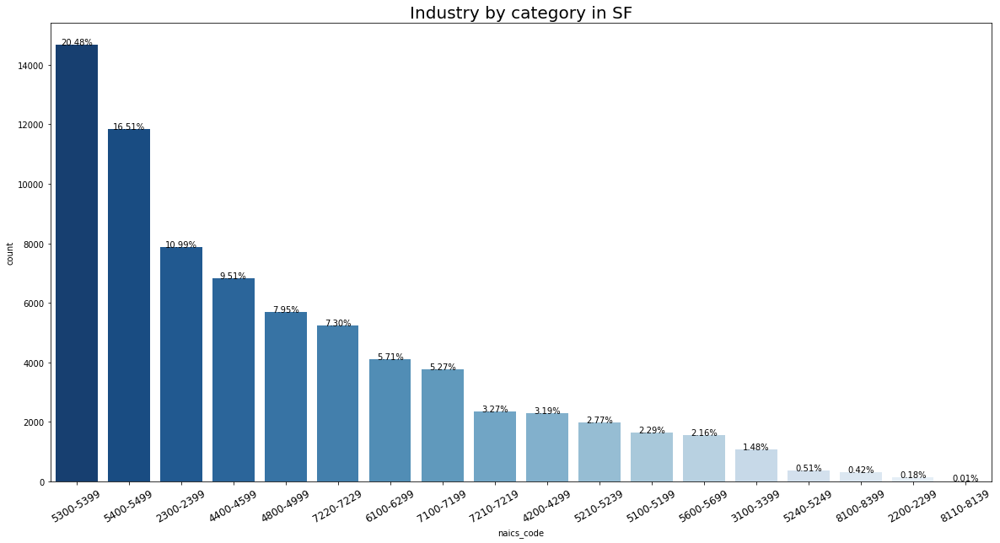

In [19]:
plt.figure(figsize=(20,10))
total = float(len(data2)) 
ax = sns.countplot(x="naics_code",palette='Blues_r', data=data2, order=data2['naics_code'].value_counts().index) 
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2%}'.format(height/total),
            ha="center") 
ax.axes.set_title("Industry by category in SF", fontsize=20)
plt.xticks(rotation=30,fontsize=12)
plt.show()

In [20]:
data2a=data2.loc[data2['naics_code'].isin(['3100-3399','5240-5249','8100-8399','2200-2299','8110-8139'])]
pd.crosstab(data2a.naics_code, data2a.naics_code_description)

naics_code_description,Certain Services,Insurance,Manufacturing,Utilities
naics_code,,,,
2200-2299,0,0,0,130
3100-3399,0,0,1064,0
5240-5249,0,366,0,0
8100-8399,301,0,0,0
8110-8139,7,0,0,0


** The less popular and newer industries, such as utilities, manufacturing and insurance can benefit the most from the government's new tax scheme. **

## Q3 : Different industry types that have emerge in San Francisco over the years

In [21]:
### here I look past 10 year data
data3=data2[(data2['bus_st_yr']>=2008) & (data2['bus_st_yr']<=2018)]
data3['bus_st_yr'].value_counts()

2015    6600
2014    6062
2016    5123
2013    4142
2012    3570
2011    3192
2010    2838
2009    2442
2008    2187
Name: bus_st_yr, dtype: int64

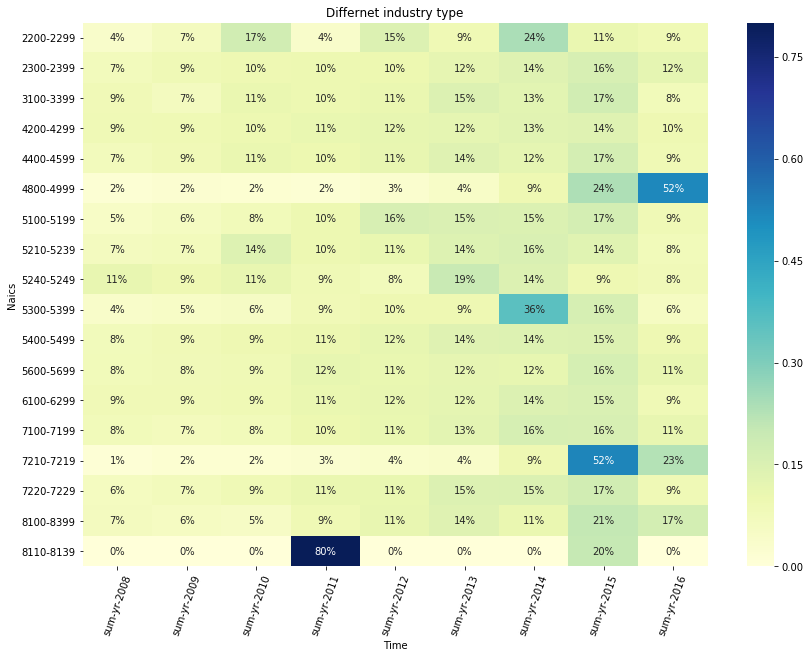

In [22]:
data3a=pd.DataFrame(data3.groupby(['naics_code','bus_st_yr']).size().reset_index().rename(columns={0:'yr'}))
table=pd.pivot_table(data3a,index=['naics_code'],values=['yr'],
               columns=["bus_st_yr"],aggfunc=[np.sum], margins=True, dropna=True, fill_value=0)
tbale1=table.div(table.iloc[:,-1],axis=0)
data3a_freq=tbale1.iloc[:-1,:-1]
# visualize 
f,ax=plt.subplots(figsize=(14,10))
sns.heatmap(data3a_freq, annot=True, cmap="YlGnBu", fmt='.0%')
plt.title('Differnet industry type')
plt.ylabel('Naics')
plt.xlabel('Time')
plt.xticks(rotation=70,fontsize=10)
plt.show()

In [23]:
data3b=data3.loc[data3['naics_code'].isin(['2200-2299','4800-4999','5300-5399','7210-7199', '8110-8139', '7210-7219'])]
pd.crosstab(data3b.naics_code, data3b.naics_code_description)

naics_code_description,Accommodations,Certain Services,Real Estate and Rental and Leasing Services,Transportation and Warehousing,Utilities
naics_code,,,,,
2200-2299,0,0,0,0,75
4800-4999,0,0,0,3721,0
5300-5399,0,0,5539,0,0
7210-7219,1650,0,0,0,0
8110-8139,0,5,0,0,0


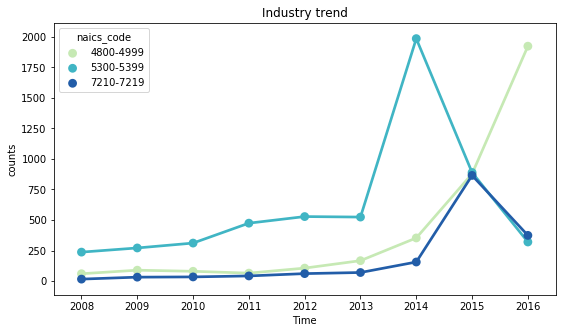

In [24]:
data3c=data3a.loc[data3a['naics_code'].isin(['4800-4999','5300-5399','7210-7219'])]
plt.figure(figsize=(9,5))
g=sns.pointplot(x="bus_st_yr", y="yr", hue="naics_code", data=data3c, palette="YlGnBu")
plt.title('Industry trend')
plt.ylabel('counts')
plt.xlabel('Time')
plt.show()

**The Transportation and Warehousing industry is showing an upward trend in growth.** 

## Q4) What other conclusions can be drawn from the data?
** Here are some interesting finds **
+ The overall percentage of businesses that fail in SF? **28%**
+ The average business last across all industries is **6 year**
+ Which industry has the shortest business longevity?  **Transportation and Warehousing**
+ Which industry pays the most parking taxes? **Real Estate and Rental and Leasing Services pays the most Parking taxes**
+ Which industry pays the most transient occupancy tax (TOT)? **Accommodations**

#### What is the overall percentage of businesses that fail in SF?

In [25]:
(1-(data_sf['location_end_date'].isnull().sum()/len(data_sf)))

0.27870679518117802

In [26]:
# filter inactive business and remove missing value in the location
data_inact=data_sf[data_sf['location_end_date'].notnull()]
data_inact=data_inact[data_inact['business_location'].notnull()]
data_inact.shape

(53733, 27)

In [27]:
data_inact['loc_st_dt']=data_inact.location_start_date.apply(lambda x: x.year)
data_inact['loc_end_dt']=data_inact.location_end_date.apply(lambda x: x.year)
data_inact['dif_in_yr']=data_inact['loc_end_dt']-data_inact['loc_st_dt']
data_inact['dif_in_yr'].describe()

count    53733.000000
mean         6.152346
std          8.413227
min        -44.000000
25%          1.000000
50%          3.000000
75%          8.000000
max         68.000000
Name: dif_in_yr, dtype: float64

#### How long does the average business last across all industries and by industry ?

In [28]:
### filter data with location_start_date<location_end_date 
data_inact=data_inact[(data_inact['dif_in_yr']>=0)]
# overall 
print(data_inact['dif_in_yr'].mean())
# by industry 
print("\n")
print(data_inact['dif_in_yr'].groupby(data_inact['naics_code']).mean())

6.2036957295


naics_code
2200-2299     5.700000
2300-2399     5.516012
3100-3399     6.862500
4200-4299     7.771562
4400-4599     6.845548
4800-4999     2.710711
5100-5199     3.520270
5210-5239     5.196629
5240-5249     8.240385
5300-5399    14.407101
5400-5499     5.323109
5600-5699     5.097328
6100-6299     5.885417
7100-7199     5.615783
7210-7219     5.756501
7220-7229     5.312627
8100-8139     5.884876
8100-8399     6.300971
8110-8139     4.661765
Name: dif_in_yr, dtype: float64


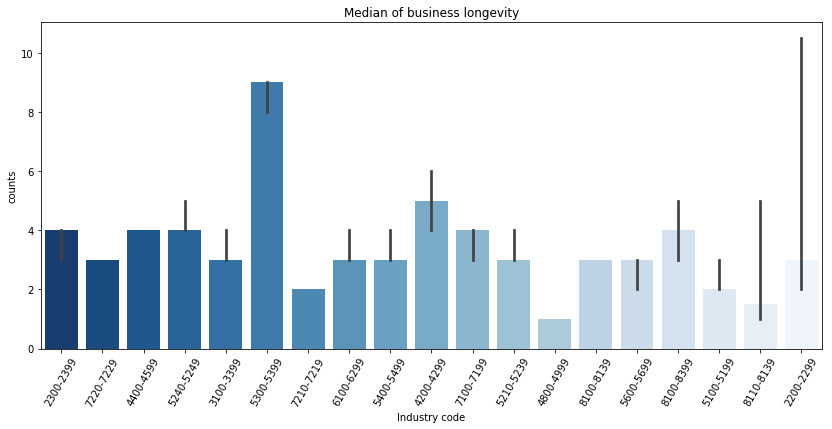

In [29]:
plt.figure(figsize=(14,6))
ax = sns.barplot(x="naics_code", y="dif_in_yr", data=data_inact, palette='Blues_r', estimator=median)
plt.xticks(rotation=60,fontsize=10)
plt.title('Median of business longevity')
plt.ylabel('counts')
plt.xlabel('Industry code')
plt.show()

#### Real Estate and Rental and Leasing Services pays the most for parking taxes.

In [30]:
data_sf.groupby(['naics_code','naics_code_description'])['parking_tax'].sum().reset_index().rename(columns={0:'count'})

,naics_code,naics_code_description,parking_tax
0,2200-2299,Utilities,0
1,2300-2399,Construction,0
2,3100-3399,Manufacturing,0
3,4200-4299,Wholesale Trade,0
4,4400-4599,Retail Trade,108
5,4800-4999,Transportation and Warehousing,22
6,5100-5199,Information,2
7,5210-5239,Financial Services,2
8,5240-5249,Insurance,0
9,5300-5399,Real Estate and Rental and Leasing Services,462


#### Which industry pays the most transient occupancy tax (TOT)? 

In [31]:
data_sf.groupby(['naics_code','naics_code_description'])['transient_occupancy_tax'].sum().reset_index().rename(columns={0:'count'})

,naics_code,naics_code_description,transient_occupancy_tax
0,2200-2299,Utilities,5
1,2300-2399,Construction,18
2,3100-3399,Manufacturing,3
3,4200-4299,Wholesale Trade,9
4,4400-4599,Retail Trade,15
5,4800-4999,Transportation and Warehousing,47
6,5100-5199,Information,11
7,5210-5239,Financial Services,6
8,5240-5249,Insurance,3
9,5300-5399,Real Estate and Rental and Leasing Services,522


# Further analysis 

**For Business** : 
+ If we can determine the less popular places with high business survival rates, then we can recommend that businesses open new business locations there, which will allow them to avoid over-competitive markets or over-saturated areas. 


**For Government** : 
+ We can investigate further to determine whether there is any relationship between paying parking taxes, transient occupancy tax and a business’s survival rate. For example, is there a pattern indicating whether a business that pays parking taxes has a lower business survival rate that businesses that do not parking taxes?  If we can find the pattern, then we can suggest that the government reduce the parking tax as an incentive for new businesses. Maybe the government can waive the parking tax for two years for a new business to encourage people set up businesses in San Francisco. 

**Machine Learning** : 
Many possible models can be built based on the business problems we want to solve. 

+ **Supervised Learning** : 
We can apply classification algorithms  to build the prediction model of business success or failure based on latitude, longitude and other features.

+ **Unsupervised Learning** :
We can use K-means clustering to segment businesses and then provide different tax schemes or incentive programs to encourage entrepreneurs to set up business in San Francisco. 